In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import cv2
import tensorflow as tf
def load_and_preprocess_image(path):

# name = path.split("/")[-1].split(".")[0]
  image = cv2.imread(path, cv2.IMREAD_COLOR)
  h, w, _ = image.shape

# x = cv2.resize(image,(W, H))
  x = cv2.imread(path, cv2.IMREAD_COLOR)
# x = x/255.0
  x = x.astype(np.float32)
  x = cv2.resize(x,[512, 512])

  x = np.expand_dims(x, axis=0)
  return x

In [ ]:
def preprocess_segmentation_output(x):

  #Resize the image
  img = tf.image.resize(x,size = [224,224])
  img = np.repeat(img, 3, axis=2)
  img = tf.expand_dims(img,axis=0)
  #Rescale the image (get all values between 0 and 1)
  # img = img/255.
  return img

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import backend as K

def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

smooth = 1e-15
def dice_coef(y_true, y_pred):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)

def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

In [ ]:
import numpy as np
import tensorflow as tf
import cv2
from google.colab.patches import cv2_imshow
# Load the image segmentation and classification models
segmentation_model = tf.keras.models.load_model('/content/drive/MyDrive/ColabNotebooks/Models/Object_Segmentation_Model.h5',custom_objects={'dice_loss': dice_loss,"dice_coef":dice_coef,"iou":iou})
classification_model = tf.keras.models.load_model('/content/drive/MyDrive/ColabNotebooks/Models/Human_Non_Human_Model.h5')

# path = '/content/cropped_image.jpg'
# # Load and preprocess your input image
# input_image = load_and_preprocess_image(path)
# image = cv2.imread(path, cv2.IMREAD_COLOR)
# h, w, _ = image.shape
# # Perform image segmentation
# segmentation_output = segmentation_model.predict(input_image)[0]
# y = segmentation_output
# print(y.shape)
# y = cv2.resize(y, (w, h))
# y = np.expand_dims(y, axis=-1)
# masked_image = image * y
# # print(masked_image)

# line = np.ones((h, 10, 3)) * 128
# cat_images = np.concatenate([image, line, masked_image], axis=1)
#        # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
# cv2_imshow(cat_images)

# # Preprocess the segmentation output
# preprocessed_segmentation_output = preprocess_segmentation_output(segmentation_output)
# preprocessed_segmentation_output.shape
# # # Perform classification on the preprocessed segmentation output
# classification_result = classification_model.predict(preprocessed_segmentation_output)

# # Make a prediction based on the classification result
# if classification_result > 0.4:  # You may need to adjust the threshold
#     final_prediction = "Human"
# else:
#     final_prediction = "Non-Human"

# print(f"The image is classified as: {final_prediction}")


In [ ]:
# # Specify the path to your ZIP file
# zip_file_path = '/content/drive/MyDrive/Val_Trimmed.zip'

# # Specify the target directory where you want to extract the contents
# extracted_dir_path = '/content/drive/MyDrive/dataset_final'

# # Use the 'unzip' command to extract the ZIP file
# !unzip -q "$zip_file_path" -d "$extracted_dir_path"


In [ ]:
import cv2
import os

# Path to the folder containing the images in your Google Drive
folder_path = '/content/drive/MyDrive/dataset_final/Val_Trimmed'

# List to store the preprocessed images
preprocessed_images = []

# Iterate through the images in the folder
for img_file in os.listdir(folder_path):
    # Load the image
    # print(" img_file ",img_file)
    img_path = os.path.join(folder_path, img_file)
    # print("img_path ", img_path)
    img = load_and_preprocess_image(img_path)
    # img = tf.squeeze(img, axis=1)
    # img = tf.expand_dims(img,axis = 0)
    preprocessed_images.append(img)

# Convert the list of preprocessed images to a NumPy array
preprocessed_images = np.array(preprocessed_images)

# Display the shape of the preprocessed images
print('Preprocessed Images Shape:', preprocessed_images.shape)
print(preprocessed_images[0].shape)

Preprocessed Images Shape: (700, 1, 512, 512, 3)
(1, 512, 512, 3)


In [ ]:
import cv2
import os

# Path to the folder containing original images
original_images_folder = '/content/drive/MyDrive/dataset_final/Val_Trimmed'

# Path to the folder containing predicted segmentation masks
# predicted_masks_folder = '/content/dataset/Masks'
# Iterate through the images in the folder
for filename in os.listdir(original_images_folder):
    if filename.endswith(('.jpg', '.png')):
        # Load the original image
        path = os.path.join(original_images_folder, filename)
        image = cv2.imread(path, cv2.IMREAD_COLOR)
        h, w, _ = image.shape

# x = cv2.resize(image,(W, H))
        x = cv2.imread(path, cv2.IMREAD_COLOR)
# x = x/255.0
        x = x.astype(np.float32)
        x = cv2.resize(x,[512, 512])

        x = np.expand_dims(x, axis=0)

        y = segmentation_model.predict(x)[0]
# print(y)
        y = cv2.resize(y, (w, h))
        y = np.expand_dims(y, axis=-1)
        masked_image = image * y
# print(masked_image)

        line = np.ones((h, 10, 3)) * 128
        cat_images = np.concatenate([image, line, masked_image], axis=1)
       # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
        results_path = os.path.join("/content/drive/MyDrive/dataset_final/Results_Segmentation", filename)
        cv2.imwrite(results_path,cat_images)
        cv2_imshow(cat_images)
#         # Load the corresponding predicted segmentation mask
#         # image = cv2.imread(path, )
#         h, w, _ = input_image.shape
# # Perform image segmentation
#         segmentation_output = segmentation_model.predict(input_image)[0]
#         y = segmentation_output
#         print(y.shape)
#         y = cv2.resize(y, (w, h))
#         y = np.expand_dims(y, axis=-1)
#         masked_image = input_image * y
# # print(masked_image)

#         line = np.ones((h, 10, 3)) * 128
#         cat_images = np.concatenate([input_image, line, masked_image], axis=1)
#        # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
#         cv2_imshow(cat_images)


In [ ]:
import numpy as np
from sklearn.cluster import KMeans

# Example predicted scores (replace this with your actual predicted scores)
predicted_scores = np.random.rand(512, 512)

# Flatten the predicted scores and reshape for clustering
flattened_scores = predicted_scores.flatten().reshape(-1, 1)

# Perform K-means clustering
n_clusters = 2  # Adjust the number of clusters based on your use case
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(flattened_scores)
cluster_centers = kmeans.cluster_centers_
cluster_labels = kmeans.labels_

# Calculate a measure of accuracy based on cluster homogeneity
# Example: ratio of intra-cluster variance to total variance
intra_cluster_variance = np.sum((flattened_scores - cluster_centers[cluster_labels]) ** 2)
total_variance = np.sum((flattened_scores - np.mean(flattened_scores)) ** 2)
accuracy = 1.0 - (intra_cluster_variance / total_variance)

print("Clustering Accuracy:", accuracy)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7499153462638166


In [ ]:
import numpy as np
from sklearn.cluster import KMeans
def run(path):

# Load and preprocess your input image
  input_image = load_and_preprocess_image(path)
  image = cv2.imread(path, cv2.IMREAD_COLOR)
  h, w, _ = image.shape
# Perform image segmentation
  segmentation_output = segmentation_model.predict(input_image)[0]
  predicted_scores = segmentation_output.squeeze()
  y = segmentation_output
  print(y.shape)
  y = cv2.resize(y, (w, h))
  y = np.expand_dims(y, axis=-1)
  masked_image = image * y
# print(masked_image)

  line = np.ones((h, 10, 3)) * 128
  cat_images = np.concatenate([image, line, masked_image], axis=1)
       # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
  cv2_imshow(cat_images)

# Preprocess the segmentation output
  preprocessed_segmentation_output = preprocess_segmentation_output(segmentation_output)
  preprocessed_segmentation_output.shape
# # Perform classification on the preprocessed segmentation output
  classification_result = classification_model.predict(preprocessed_segmentation_output)

# Make a prediction based on the classification result
  if classification_result > 0.5:  # You may need to adjust the threshold
      final_prediction = "Non_human"
  else:
      final_prediction = "Human"

  print(f"The image is classified as: {final_prediction}")



# # Example predicted scores (replace this with your actual predicted scores)
#   predicted_scores = np.random.rand(512, 512)

# # Flatten the predicted scores and reshape for clustering
#   flattened_scores = predicted_scores.flatten().reshape(-1, 1)

# # Perform K-means clustering
#   n_clusters = 2  # Adjust the number of clusters based on your use case
#   kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(flattened_scores)
#   cluster_centers = kmeans.cluster_centers_
#   cluster_labels = kmeans.labels_

# # Calculate a measure of accuracy based on cluster homogeneity
# # Example: ratio of intra-cluster variance to total variance
#   intra_cluster_variance = np.sum((flattened_scores - cluster_centers[cluster_labels]) ** 2)
#   total_variance = np.sum((flattened_scores - np.mean(flattened_scores)) ** 2)
#   accuracy = 1.0 - (intra_cluster_variance / total_variance)

#   print("Clustering Accuracy:", accuracy)


1/1 [==============================] - 6s 6s/step
(512, 512, 1)


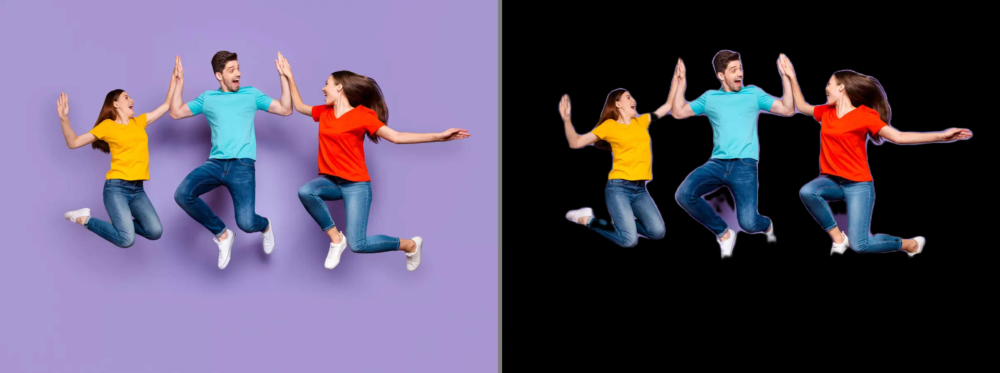

1/1 [==============================] - 0s 194ms/step
The image is classified as: Non_human


In [ ]:
run("/content/actual_image.jpg")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


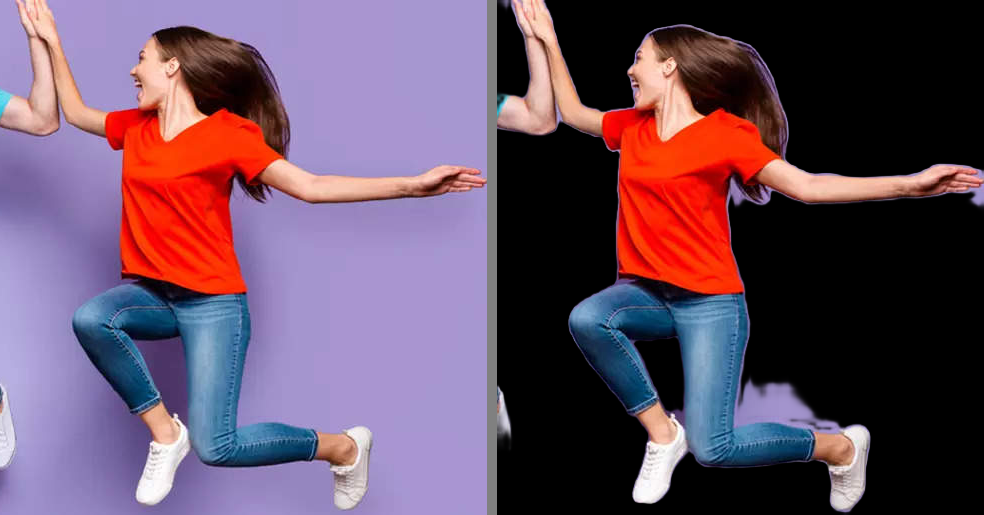

1/1 [==============================] - 0s 78ms/step
The image is classified as: Non_human


In [ ]:
run("/content/Crop_1.png")

1/1 [==============================] - 4s 4s/step
(512, 512, 1)


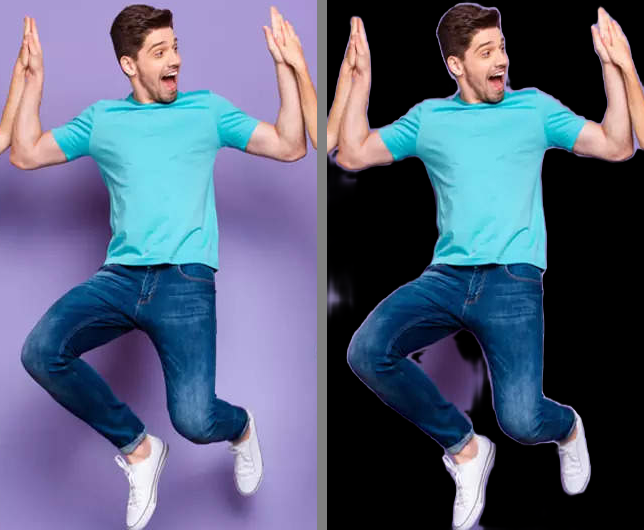

1/1 [==============================] - 0s 76ms/step
The image is classified as: Non_human


In [ ]:
run("/content/crop_2.png")

1/1 [==============================] - 4s 4s/step
(512, 512, 1)


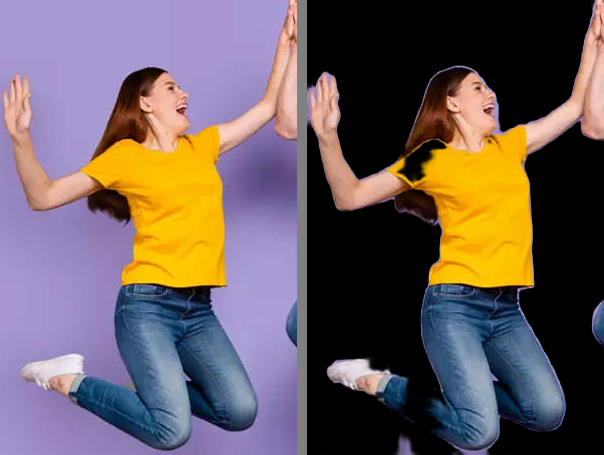

1/1 [==============================] - 0s 78ms/step
The image is classified as: Human


In [ ]:
run("/content/crop_3.png")

1/1 [==============================] - 7s 7s/step
(512, 512, 1)


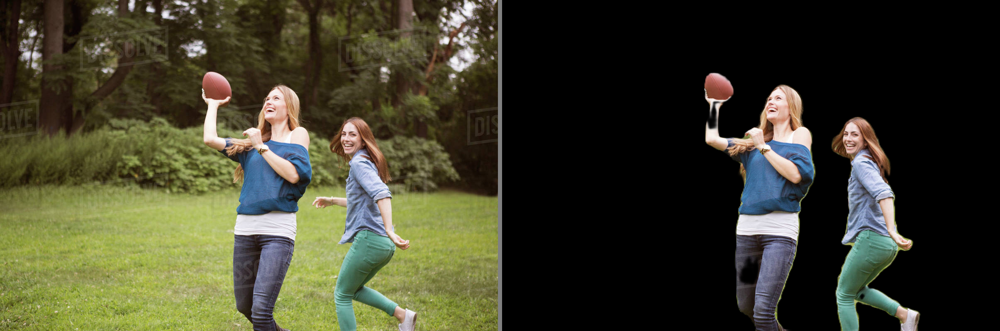

1/1 [==============================] - 0s 397ms/step
The image is classified as: Non_human


In [ ]:
run("/content/D1061_25_979_1200.jpg")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


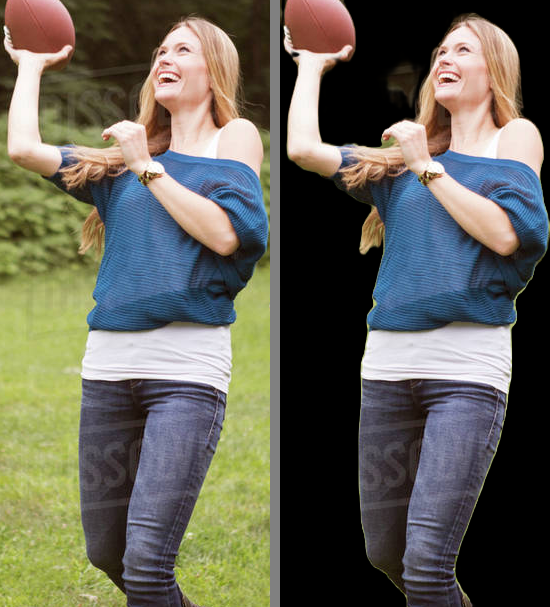

1/1 [==============================] - 0s 86ms/step
The image is classified as: Human


In [ ]:
run("/content/download (11).png")

1/1 [==============================] - 4s 4s/step
(512, 512, 1)


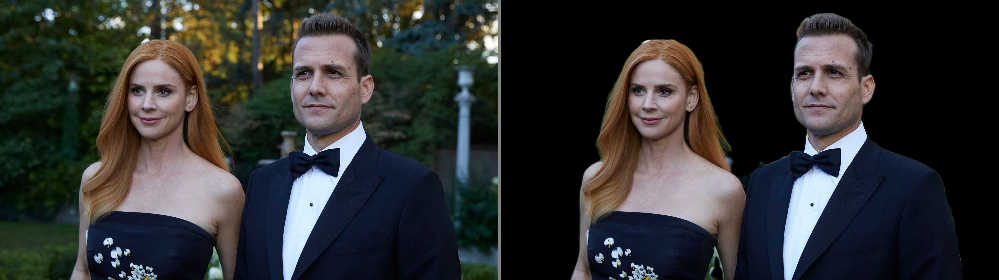

1/1 [==============================] - 0s 82ms/step
The image is classified as: Non_human


In [ ]:
run("/content/actual_image.jpeg")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


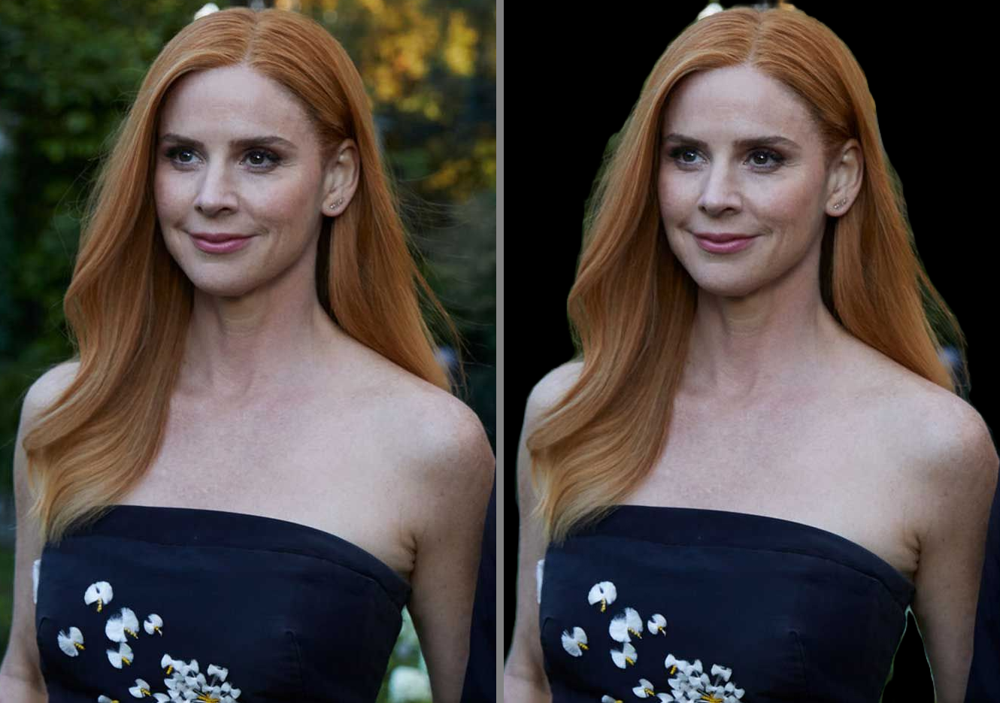

1/1 [==============================] - 0s 129ms/step
The image is classified as: Human


In [ ]:
run("/content/Crop_1.png")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


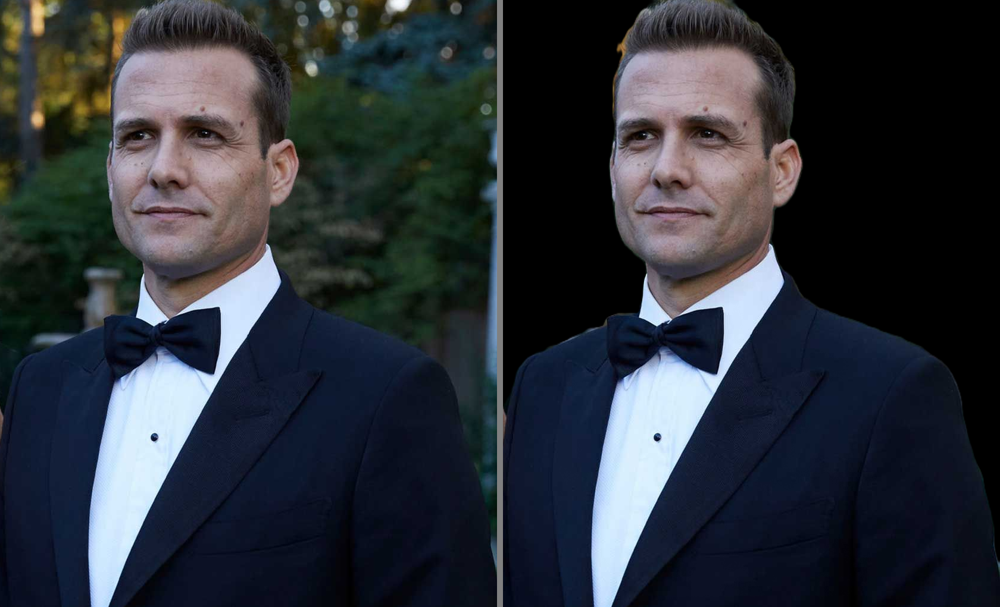

1/1 [==============================] - 0s 107ms/step
The image is classified as: Human


In [ ]:
run("/content/Crop_2.png")

1/1 [==============================] - 5s 5s/step
(512, 512, 1)


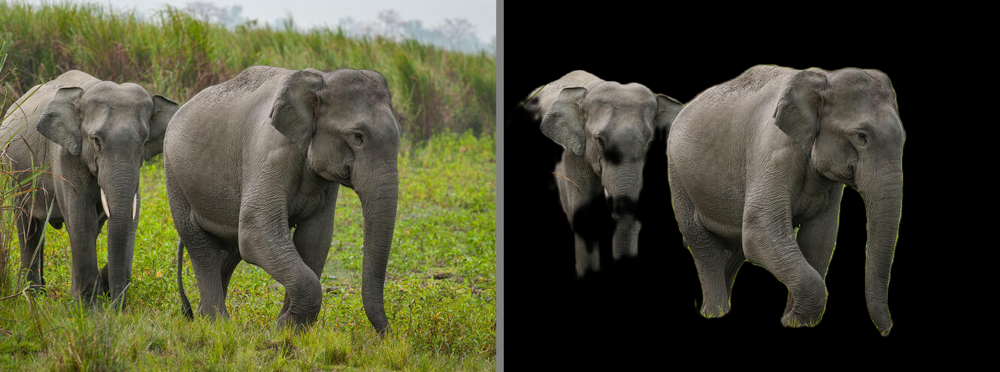

1/1 [==============================] - 0s 104ms/step
The image is classified as: Human


In [ ]:
run("/content/6alkr00kmx_Asian_Elephants_WW252891.jpg")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


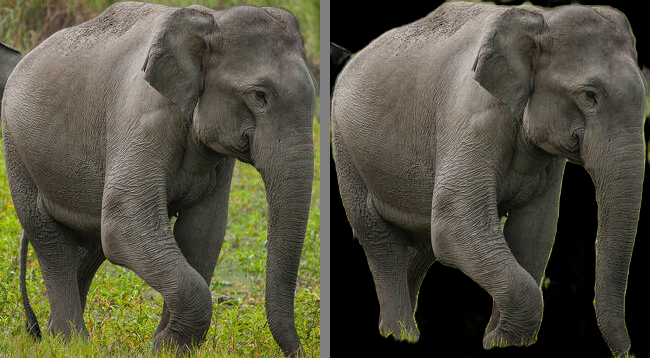

1/1 [==============================] - 0s 82ms/step
The image is classified as: Non_human


In [ ]:
run("/content/crop_1.png")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


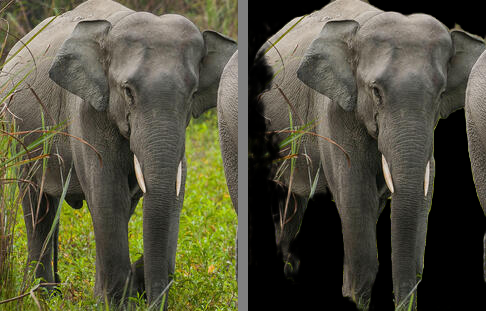

1/1 [==============================] - 0s 73ms/step
The image is classified as: Non_human


In [ ]:
run("/content/crop_2.png")

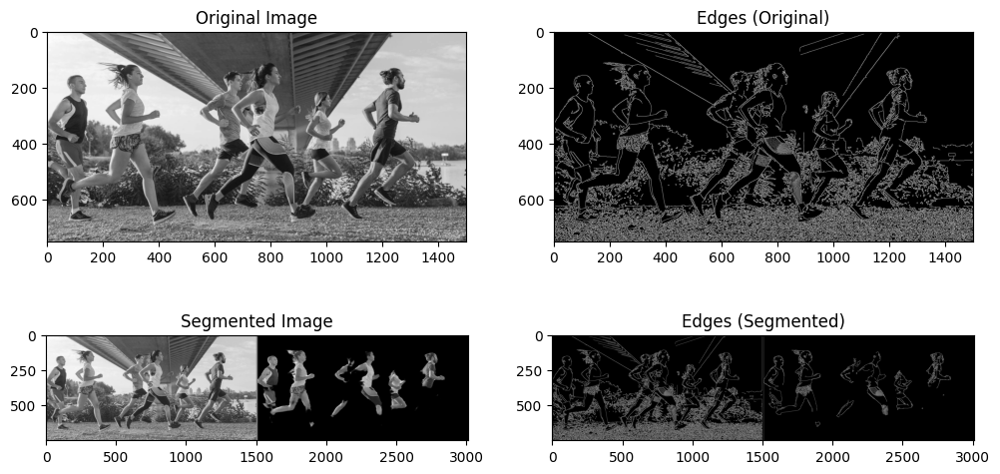

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the original and segmented images
original_image = cv2.imread('/content/running-facts (1).jpg', cv2.IMREAD_GRAYSCALE)
segmented_image = cv2.imread('/content/download (24).png', cv2.IMREAD_GRAYSCALE)

# Apply Canny edge detection to both images
edges_original = cv2.Canny(original_image, 100, 200)
edges_segmented = cv2.Canny(segmented_image, 100, 200)

# Overlay the edges on the images
overlay_original = cv2.addWeighted(original_image, 0.5, edges_original, 0.5, 0)
overlay_segmented = cv2.addWeighted(segmented_image, 0.5, edges_segmented, 0.5, 0)

# Display the images with edges overlaid
plt.figure(figsize=(12, 6))
plt.subplot(2, 2, 1), plt.imshow(original_image, cmap='gray'), plt.title('Original Image')
plt.subplot(2, 2, 2), plt.imshow(edges_original, cmap='gray'), plt.title('Edges (Original)')
plt.subplot(2, 2, 3), plt.imshow(segmented_image, cmap='gray'), plt.title('Segmented Image')
plt.subplot(2, 2, 4), plt.imshow(edges_segmented, cmap='gray'), plt.title('Edges (Segmented)')
plt.show()


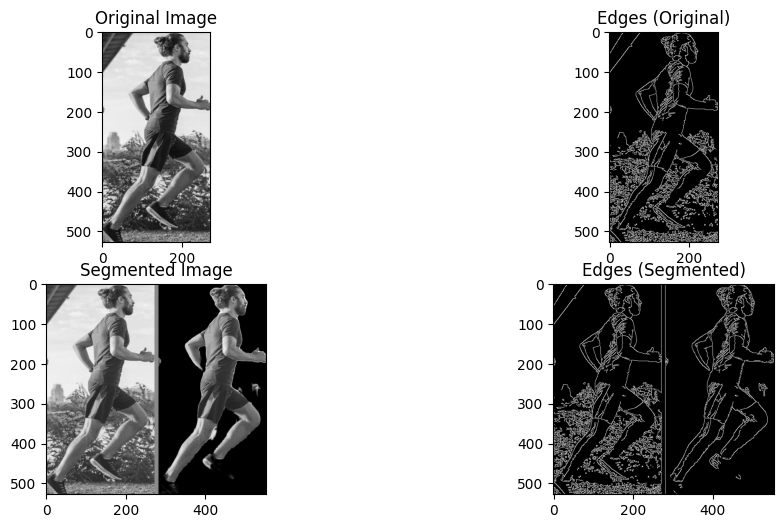

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the original and segmented images
original_image = cv2.imread('/content/download (10).png', cv2.IMREAD_GRAYSCALE)
segmented_image = cv2.imread('/content/download (25).png', cv2.IMREAD_GRAYSCALE)

# Apply Canny edge detection to both images
edges_original = cv2.Canny(original_image, 100, 200)
edges_segmented = cv2.Canny(segmented_image, 100, 200)

# Overlay the edges on the images
overlay_original = cv2.addWeighted(original_image, 0.5, edges_original, 0.5, 0)
overlay_segmented = cv2.addWeighted(segmented_image, 0.5, edges_segmented, 0.5, 0)

# Display the images with edges overlaid
plt.figure(figsize=(12, 6))
plt.subplot(2, 2, 1), plt.imshow(original_image, cmap='gray'), plt.title('Original Image')
plt.subplot(2, 2, 2), plt.imshow(edges_original, cmap='gray'), plt.title('Edges (Original)')
plt.subplot(2, 2, 3), plt.imshow(segmented_image, cmap='gray'), plt.title('Segmented Image')
plt.subplot(2, 2, 4), plt.imshow(edges_segmented, cmap='gray'), plt.title('Edges (Segmented)')
plt.show()


In [ ]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

# Load the original and cropped images
original_image = cv2.imread('/content/download (24).png', cv2.IMREAD_COLOR)
cropped_image = cv2.imread('/content/download (10).png', cv2.IMREAD_COLOR)

# Resize the cropped image to match the dimensions of the original image
cropped_image = cv2.resize(cropped_image, (original_image.shape[1], original_image.shape[0]))

# Convert images to grayscale (SSIM works on grayscale images)
original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
cropped_gray = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2GRAY)

# Compute SSIM
ssim_index, _ = ssim(original_gray, cropped_gray, full=True)

print(f'SSIM: {ssim_index}')

# Convert images to float32 for PSNR calculation
original_image = original_image.astype(np.float32)
cropped_image = cropped_image.astype(np.float32)

# Compute the mean squared error (MSE)
mse = np.mean((original_image - cropped_image) ** 2)

# Calculate PSNR
max_pixel = 255.0
psnr = 10.0 * np.log10((max_pixel ** 2) / mse)

print(f'PSNR: {psnr} dB')


SSIM: 0.17681680412245362
PSNR: 7.366878094387631 dB


In [ ]:
import cv2
import numpy as np

# Load the original and cropped images
original_image = cv2.imread('/content/download (26).png', cv2.IMREAD_COLOR)
cropped_image = cv2.imread('/content/download (10).png', cv2.IMREAD_COLOR)

# Convert images to grayscale
original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
cropped_gray = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2GRAY)

# Apply Canny edge detection
edges_original = cv2.Canny(original_gray, 100, 200)
edges_cropped = cv2.Canny(cropped_gray, 100, 200)

# Calculate edge density (average edge intensity)
edge_density_original = np.mean(edges_original)
edge_density_cropped = np.mean(edges_cropped)

print(f'Edge Density (Original): {edge_density_original}')
print(f'Edge Density (Cropped): {edge_density_cropped}')


Edge Density (Original): 4.95089321692411
Edge Density (Cropped): 30.57528409090909


In [ ]:
import cv2
import numpy as np

# Load the original and cropped images
original_image = cv2.imread('/content/download (24).png', cv2.IMREAD_COLOR)
cropped_image = cv2.imread('/content/download (10).png', cv2.IMREAD_COLOR)

# Convert images from BGR to RGB
original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
cropped_image_rgb = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)

# Calculate mean color for each image
mean_color_original = np.mean(original_image_rgb, axis=(0, 1))
mean_color_cropped = np.mean(cropped_image_rgb, axis=(0, 1))

# Compute Euclidean distance between mean colors
euclidean_distance = np.linalg.norm(mean_color_original - mean_color_cropped)

# Calculate color histograms for each image
hist_original = cv2.calcHist([original_image_rgb], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
hist_cropped = cv2.calcHist([cropped_image_rgb], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])

# Normalize the histograms
hist_original /= hist_original.sum()
hist_cropped /= hist_cropped.sum()

# Calculate histogram intersection for color histogram comparison
hist_intersection = cv2.compareHist(hist_original, hist_cropped, cv2.HISTCMP_INTERSECT)

print(f'Euclidean Distance of Mean Colors: {euclidean_distance}')
print(f'Color Histogram Intersection: {hist_intersection}')


Euclidean Distance of Mean Colors: 98.65737953524702
Color Histogram Intersection: 0.43993444088110323


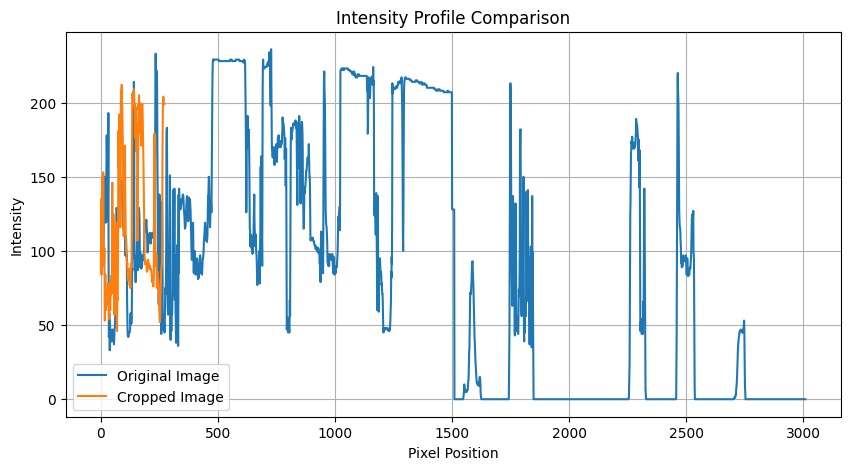

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the original and cropped images
original_image = cv2.imread('/content/download (24).png', cv2.IMREAD_GRAYSCALE)
cropped_image = cv2.imread('/content/download (10).png', cv2.IMREAD_GRAYSCALE)

# Define a path (e.g., a horizontal line at the center of the image)
path_row = original_image.shape[0] // 2
path = original_image[path_row, :]

# Extract intensity profiles along the defined path
intensity_profile_original = original_image[path_row, :]
intensity_profile_cropped = cropped_image[path_row, :]

# Plot the intensity profiles
plt.figure(figsize=(10, 5))
plt.plot(intensity_profile_original, label='Original Image')
plt.plot(intensity_profile_cropped, label='Cropped Image')
plt.xlabel('Pixel Position')
plt.ylabel('Intensity')
plt.title('Intensity Profile Comparison')
plt.legend()
plt.grid()
plt.show()


1/1 [==============================] - 5s 5s/step
(512, 512, 1)


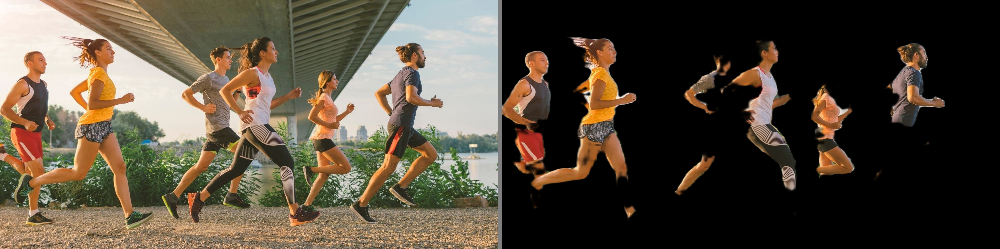

1/1 [==============================] - 0s 348ms/step
The image is classified as: Non_human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7501781952809274


In [ ]:
run("/content/running-facts (1).jpg")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


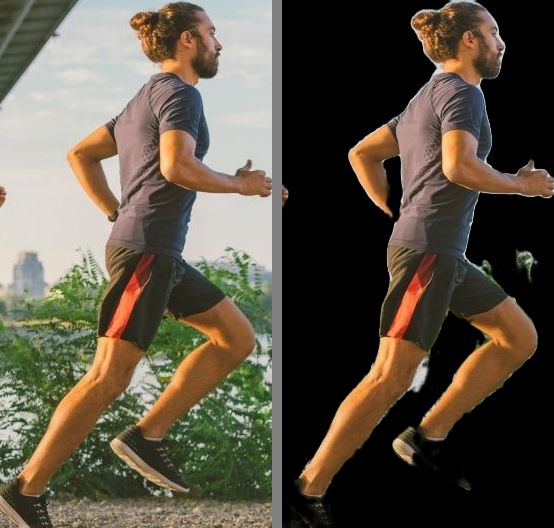

1/1 [==============================] - 0s 49ms/step
The image is classified as: Human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7510890614907502


In [ ]:
run("/content/download (10).png")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


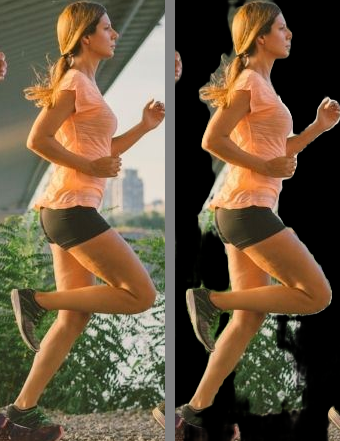

1/1 [==============================] - 0s 47ms/step
The image is classified as: Human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7511640287579547


In [ ]:
run("/content/download (11).png")

1/1 [==============================] - 5s 5s/step
(512, 512, 1)


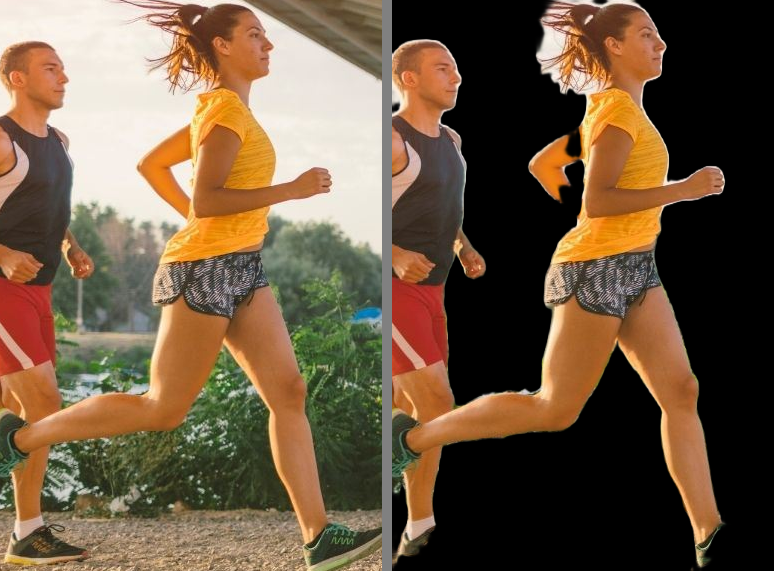

1/1 [==============================] - 0s 91ms/step
The image is classified as: Human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7500986416167159


In [ ]:
run("/content/download (23).png")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


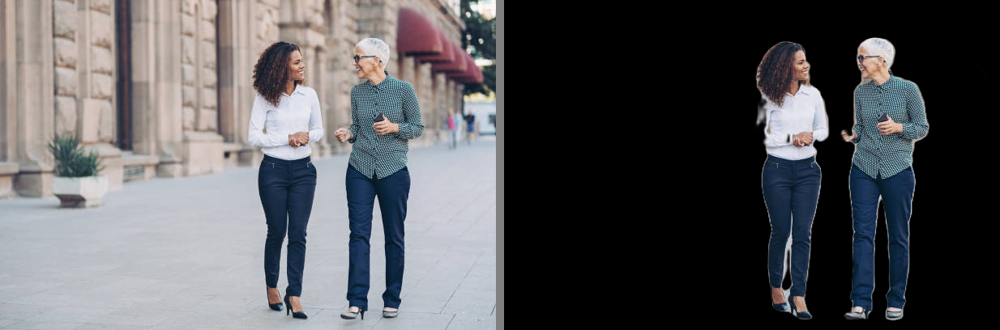

1/1 [==============================] - 0s 92ms/step
The image is classified as: Non_human


In [ ]:
run("/content/istockphoto-1287413525-612x612.jpg")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


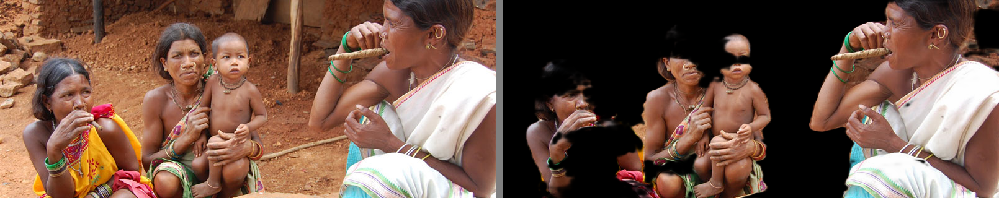

1/1 [==============================] - 0s 79ms/step
The image is classified as: Non_human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7497785319846597


In [ ]:
run("/content/tribal-villages-in-odisha.jpg")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


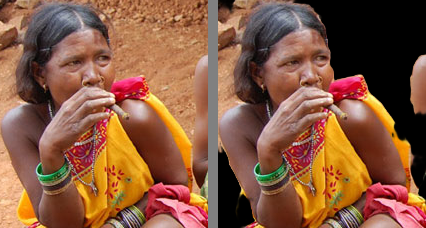

1/1 [==============================] - 0s 55ms/step
The image is classified as: Non_human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7503719488406165


In [ ]:
run("/content/download (17).png")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


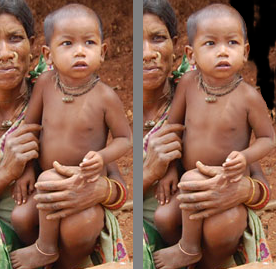

1/1 [==============================] - 0s 57ms/step
The image is classified as: Non_human


In [ ]:
run("/content/download (18).png")

1/1 [==============================] - 5s 5s/step
(512, 512, 1)


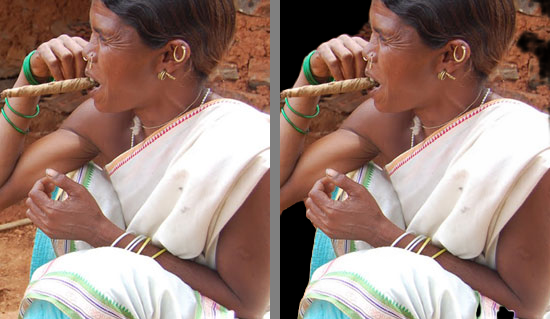

1/1 [==============================] - 0s 146ms/step
The image is classified as: Non_human


In [ ]:
run("/content/download (19).png")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


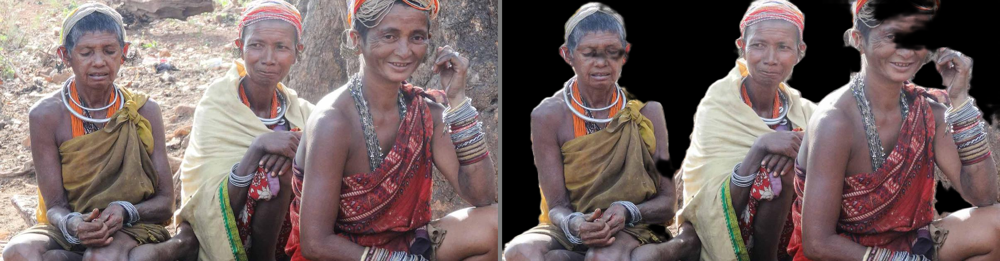

1/1 [==============================] - 0s 86ms/step
The image is classified as: Non_human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7501511277940627


In [ ]:
run("/content/160922-ztpochyekw-1624967910.jpg")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


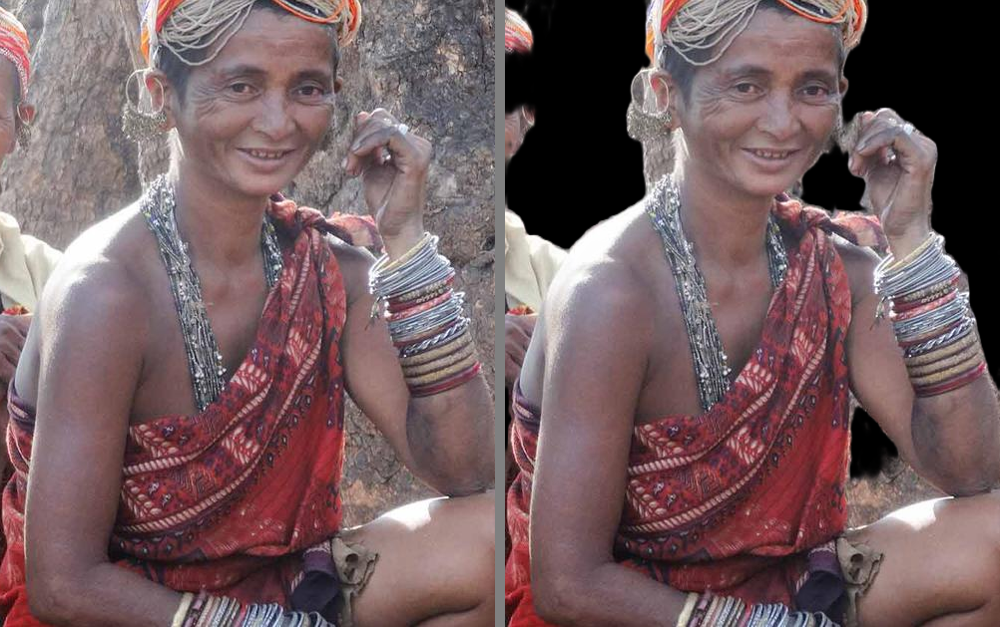

1/1 [==============================] - 0s 66ms/step
The image is classified as: Human


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clustering Accuracy: 0.7488649293647681


In [ ]:
run("/content/download (20).png")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


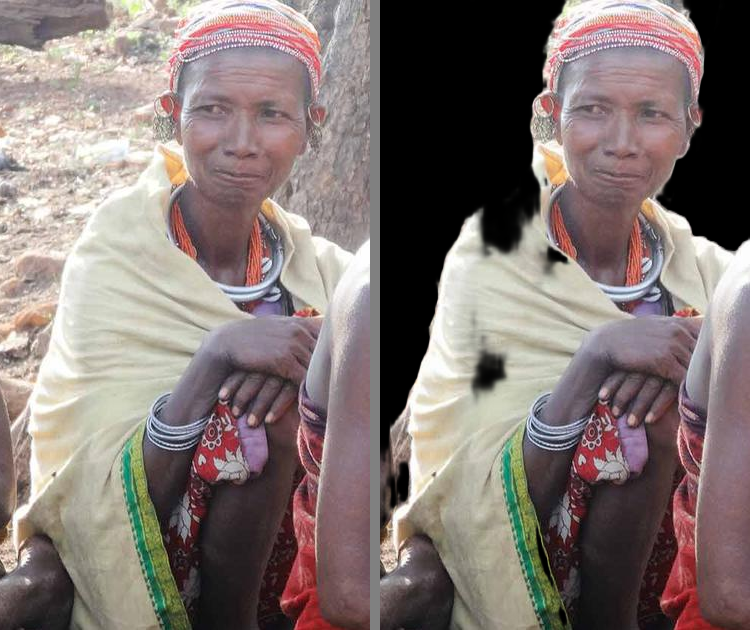

1/1 [==============================] - 0s 78ms/step
The image is classified as: Non_human


In [ ]:
run("/content/download (21).png")

1/1 [==============================] - 5s 5s/step
(512, 512, 1)


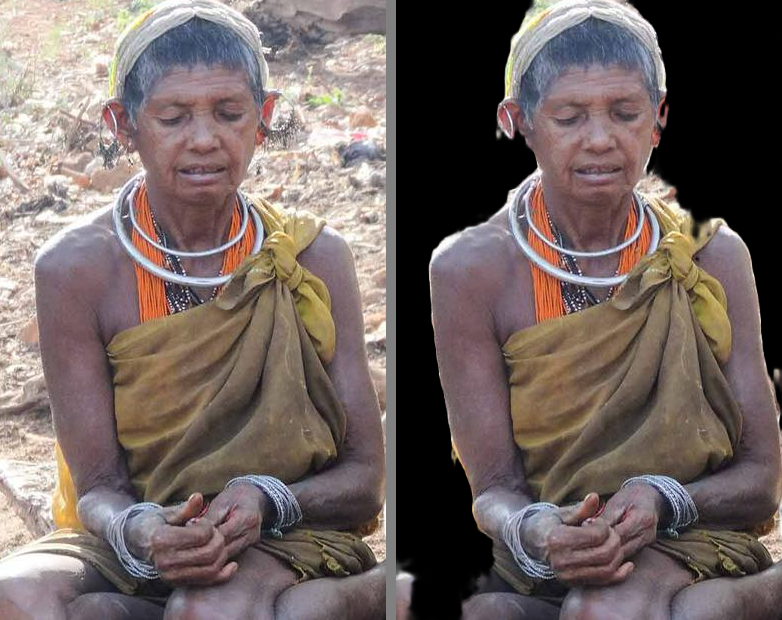

1/1 [==============================] - 0s 92ms/step
The image is classified as: Human


In [ ]:
run("/content/download (22).png")

1/1 [==============================] - 3s 3s/step
(512, 512, 1)


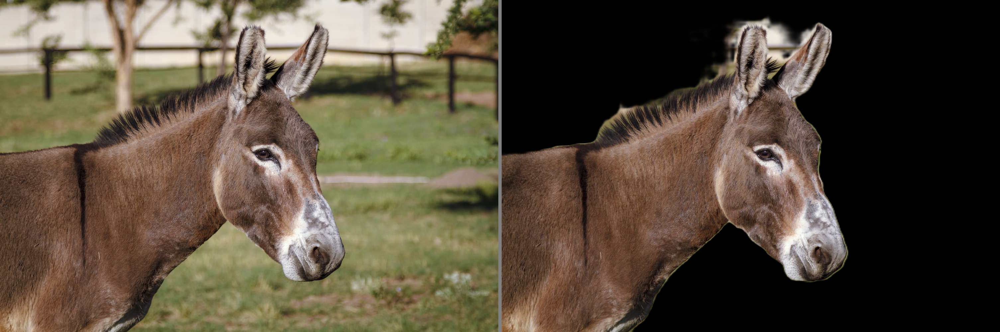

1/1 [==============================] - 0s 63ms/step
The image is classified as: Non_human


In [ ]:
path = "/content/13-aaa7d8673625450298be203d8a7a8650.jpg"
# Load and preprocess your input image
input_image = load_and_preprocess_image(path)
image = cv2.imread(path, cv2.IMREAD_COLOR)
h, w, _ = image.shape
# Perform image segmentation
segmentation_output = segmentation_model.predict(input_image)[0]
y = segmentation_output
print(y.shape)
y = cv2.resize(y, (w, h))
y = np.expand_dims(y, axis=-1)
masked_image = image * y
# print(masked_image)

line = np.ones((h, 10, 3)) * 128
cat_images = np.concatenate([image, line, masked_image], axis=1)
       # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
cv2_imshow(cat_images)

# Preprocess the segmentation output
preprocessed_segmentation_output = preprocess_segmentation_output(segmentation_output)
preprocessed_segmentation_output.shape
# # Perform classification on the preprocessed segmentation output
classification_result = classification_model.predict(preprocessed_segmentation_output)

# Make a prediction based on the classification result
if classification_result > 0.4:  # You may need to adjust the threshold
    final_prediction = "human"
else:
    final_prediction = "Non_human"

print(f"The image is classified as: {final_prediction}")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


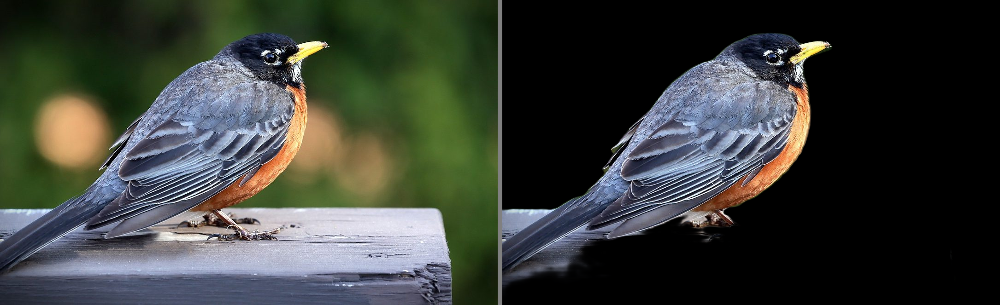

1/1 [==============================] - 0s 100ms/step
The image is classified as: Non_human


In [ ]:
path = "/content/merle-552070_1280-1080x663.jpg"
# Load and preprocess your input image
input_image = load_and_preprocess_image(path)
image = cv2.imread(path, cv2.IMREAD_COLOR)
h, w, _ = image.shape
# Perform image segmentation
segmentation_output = segmentation_model.predict(input_image)[0]
y = segmentation_output
print(y.shape)
y = cv2.resize(y, (w, h))
y = np.expand_dims(y, axis=-1)
masked_image = image * y
# print(masked_image)

line = np.ones((h, 10, 3)) * 128
cat_images = np.concatenate([image, line, masked_image], axis=1)
       # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
cv2_imshow(cat_images)

# Preprocess the segmentation output
preprocessed_segmentation_output = preprocess_segmentation_output(segmentation_output)
preprocessed_segmentation_output.shape
# # Perform classification on the preprocessed segmentation output
classification_result = classification_model.predict(preprocessed_segmentation_output)

# Make a prediction based on the classification result
if classification_result > 0.4:  # You may need to adjust the threshold
    final_prediction = "human"
else:
    final_prediction = "Non_human"

print(f"The image is classified as: {final_prediction}")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


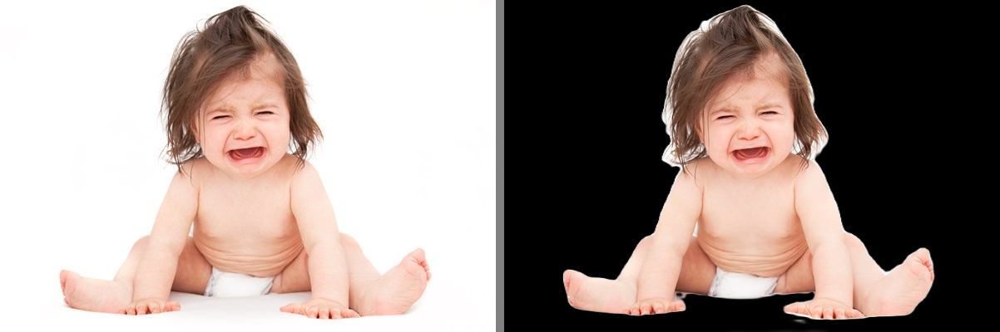

1/1 [==============================] - 0s 39ms/step
The image is classified as: Non_human


In [ ]:
path = "/content/crying.jpg"
# Load and preprocess your input image
input_image = load_and_preprocess_image(path)
image = cv2.imread(path, cv2.IMREAD_COLOR)
h, w, _ = image.shape
# Perform image segmentation
segmentation_output = segmentation_model.predict(input_image)[0]
y = segmentation_output
print(y.shape)
y = cv2.resize(y, (w, h))
y = np.expand_dims(y, axis=-1)
masked_image = image * y
# print(masked_image)

line = np.ones((h, 10, 3)) * 128
cat_images = np.concatenate([image, line, masked_image], axis=1)
       # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
cv2_imshow(cat_images)

# Preprocess the segmentation output
preprocessed_segmentation_output = preprocess_segmentation_output(segmentation_output)
preprocessed_segmentation_output.shape
# # Perform classification on the preprocessed segmentation output
classification_result = classification_model.predict(preprocessed_segmentation_output)

# Make a prediction based on the classification result
if classification_result > 0.4:  # You may need to adjust the threshold
    final_prediction = "human"
else:
    final_prediction = "Non_human"

print(f"The image is classified as: {final_prediction}")

1/1 [==============================] - 2s 2s/step
(512, 512, 1)


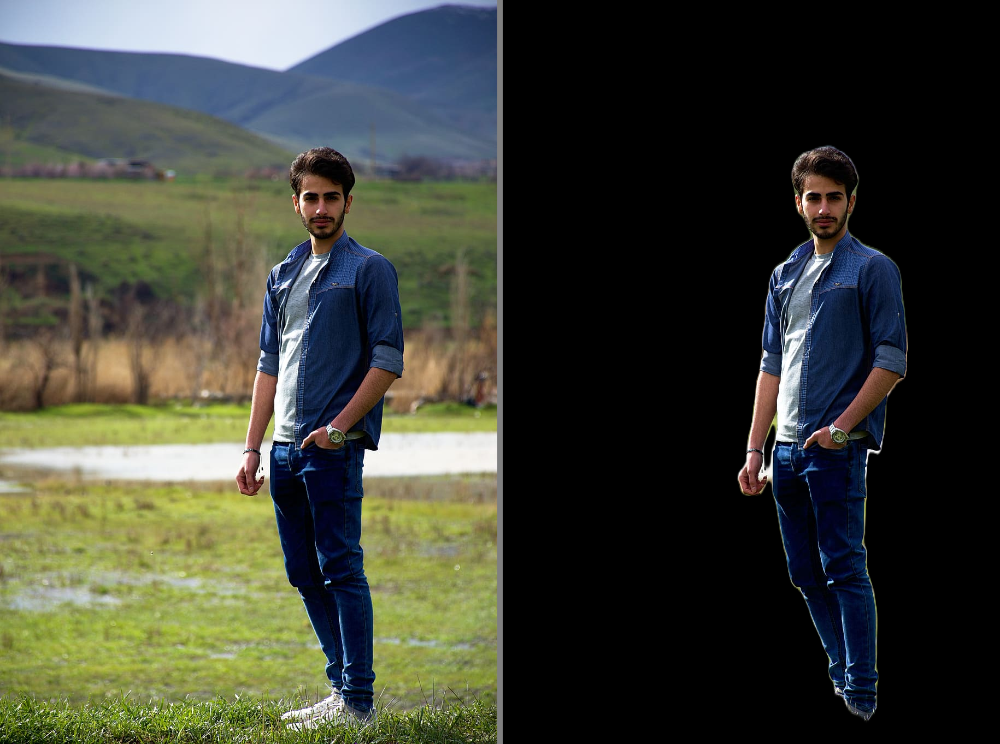

1/1 [==============================] - 0s 68ms/step
The image is classified as: human


In [ ]:
path = "/content/man-standing-on-green-grass-field.jpg"
# Load and preprocess your input image
input_image = load_and_preprocess_image(path)
image = cv2.imread(path, cv2.IMREAD_COLOR)
h, w, _ = image.shape
# Perform image segmentation
segmentation_output = segmentation_model.predict(input_image)[0]
y = segmentation_output
print(y.shape)
y = cv2.resize(y, (w, h))
y = np.expand_dims(y, axis=-1)
masked_image = image * y
# print(masked_image)

line = np.ones((h, 10, 3)) * 128
cat_images = np.concatenate([image, line, masked_image], axis=1)
       # cv2.imwrite(f"/content/Final/mask/{name}.png", cat_images)
cv2_imshow(cat_images)

# Preprocess the segmentation output
preprocessed_segmentation_output = preprocess_segmentation_output(segmentation_output)
preprocessed_segmentation_output.shape
# # Perform classification on the preprocessed segmentation output
classification_result = classification_model.predict(preprocessed_segmentation_output)

# Make a prediction based on the classification result
if classification_result > 0.4:  # You may need to adjust the threshold
    final_prediction = "human"
else:
    final_prediction = "Non_human"

print(f"The image is classified as: {final_prediction}")